# 1_behavior_eeg_preprocess

In [1]:
import os
import numpy as np
import pandas as pd
import scipy.io
import mne
from mne_bids import BIDSPath, write_raw_bids, make_dataset_description

import logging
import re

import matplotlib
#matplotlib.use('Qt5Agg')

In [2]:
# =============================================================================
# Configuration and Constants
# =============================================================================

# Set up logging: messages will include timestamp, log level, and message content
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)

# === Path configuration ===
DS_ROOT = '/volumes/hyijie_psy/CPP/high_Moerel_2024'
PATH_RAW_DATA_BIDS = '../data/data_raw_BIDS'
PATH_PREPROCESS_DARA_BIDS = '../data/preprocessData'

os.makedirs(PATH_RAW_DATA_BIDS, exist_ok=True)
os.makedirs(PATH_PREPROCESS_DARA_BIDS, exist_ok=True)

# === Constant definitions (for improved readability) ===
RESP_MARKER = 'Event/E  5'  # Response marker 1

SAMPLING_RATE = 256 

BIDS_TASK_LABEL = '_task-food'
BIDS_EEG_SUFFIX = '_eeg'

# === Subject lists ===
SUBJECT_IDS = [f'sub-{i:02d}' for i in range(1, 21)]


In [3]:
# =============================================================================
# Exclude subjects with misaligned trial counts between behavior and EEG data
# =============================================================================
sub_excluded = []

for sub_idx in SUBJECT_IDS:
    logger.info(f"Processing subject: {sub_idx}")

    # === step 1: Load eeg and behavior data ===
    # Set path for loading 
    path_eeg = os.path.join(DS_ROOT, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL+BIDS_EEG_SUFFIX + '.vhdr')
    path_beh = os.path.join(DS_ROOT, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL+'_events' + '.tsv')
    assert os.path.exists(path_eeg), f"EEG file not found: {path_eeg}"
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load eeg and behavior data
    eeg_bids = mne.io.read_raw_brainvision(path_eeg,preload=True)
    data_behavior_full = pd.read_csv(path_beh, sep='\t' , header=0)

    # === step 2: Align behavior and eeg data to get cleaned dataset ===
    # Find stimuli events to ensure that the behavior and eeg data are aligned
    data_behavior = data_behavior_full[data_behavior_full['is_faststream'] == 0]
    n_behabior = len(data_behavior)
    
    events, events_id = mne.events_from_annotations(eeg_bids)
    event_key_resp = None
    for key, value in events_id.items():
        if RESP_MARKER in key:
            event_key_resp = value

    # Validate consistency between number of stimulus events and behavioral trials
    n_events_resp = np.sum(events[:, 2] == event_key_resp)
    
    if n_events_resp != n_behabior:
        sub_excluded.append(sub_idx)
        print(f"Skipping subject {sub_idx}: n_stim_events count ({n_events_resp}) != behavior rows ({n_behabior})")
        continue

# === step 3: Save list of excluded subjects ===
if sub_excluded:
    excluded_sub_df = pd.DataFrame(sub_excluded, columns=['excluded_subjects'])
    excluded_sub_df.to_csv(
        os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv'),
        header=False,
        index=False
    )
    logger.info(f"Excluded subjects (number): {len(sub_excluded)}")
else:
    logger.info("No subjects excluded.")

2025-12-13 10:03:10,613 - INFO - Processing subject: sub-01


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-01/eeg/sub-01_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2965419  =      0.000 ...  2965.419 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:14,243 - INFO - Processing subject: sub-02


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-02/eeg/sub-02_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3078059  =      0.000 ...  3078.059 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:17,217 - INFO - Processing subject: sub-03


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-03/eeg/sub-03_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3235819  =      0.000 ...  3235.819 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:19,758 - INFO - Processing subject: sub-04


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-04/eeg/sub-04_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3351399  =      0.000 ...  3351.399 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:22,388 - INFO - Processing subject: sub-05


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-05/eeg/sub-05_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2897119  =      0.000 ...  2897.119 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:24,590 - INFO - Processing subject: sub-06


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-06/eeg/sub-06_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3061559  =      0.000 ...  3061.559 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:26,826 - INFO - Processing subject: sub-07


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-07/eeg/sub-07_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2926739  =      0.000 ...  2926.739 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:29,087 - INFO - Processing subject: sub-08


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-08/eeg/sub-08_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2641639  =      0.000 ...  2641.639 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:30,986 - INFO - Processing subject: sub-09


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-09/eeg/sub-09_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2771459  =      0.000 ...  2771.459 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:33,624 - INFO - Processing subject: sub-10


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-10/eeg/sub-10_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2762939  =      0.000 ...  2762.939 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:35,745 - INFO - Processing subject: sub-11


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-11/eeg/sub-11_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2733259  =      0.000 ...  2733.259 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:37,816 - INFO - Processing subject: sub-12


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-12/eeg/sub-12_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2696559  =      0.000 ...  2696.559 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:39,873 - INFO - Processing subject: sub-13


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-13/eeg/sub-13_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3196039  =      0.000 ...  3196.039 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:42,248 - INFO - Processing subject: sub-14


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-14/eeg/sub-14_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2687159  =      0.000 ...  2687.159 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:44,314 - INFO - Processing subject: sub-15


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-15/eeg/sub-15_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2950919  =      0.000 ...  2950.919 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:46,452 - INFO - Processing subject: sub-16


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-16/eeg/sub-16_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3020039  =      0.000 ...  3020.039 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:48,812 - INFO - Processing subject: sub-17


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-17/eeg/sub-17_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2790579  =      0.000 ...  2790.579 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:50,932 - INFO - Processing subject: sub-18


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-18/eeg/sub-18_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2633959  =      0.000 ...  2633.959 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:52,865 - INFO - Processing subject: sub-19


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-19/eeg/sub-19_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2823679  =      0.000 ...  2823.679 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:55,020 - INFO - Processing subject: sub-20


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-20/eeg/sub-20_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3057919  =      0.000 ...  3057.919 secs...
Used Annotations descriptions: [np.str_('Event/E  1'), np.str_('Event/E  2'), np.str_('Event/E  3'), np.str_('Event/E  4'), np.str_('Event/E  5'), np.str_('Event/E  8'), np.str_('Event/E  9')]


2025-12-13 10:03:57,319 - INFO - No subjects excluded.


In [4]:
# =============================================================================
# Identify and index excluded trials:
#   (1) Trials missing response in behavior data
#   (2) RT outliers (> 3 SD)
# =============================================================================
# Load the index of excluded subjects
excluded_sub_set = set() 
excluded_file = os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv')

if os.path.exists(excluded_file):
    excluded_sub_df = pd.read_csv(excluded_file, header=None)
    excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())
    logger.info(f"Loaded {len(excluded_sub_set)} excluded subjects from file.")
else:
    logger.info("No excluded subjects file found; proceeding with empty exclusion list.")

data_invalid_trials_full = []
for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    logger.info(f"Processing subject: {sub_idx}")
    # === step 1: Load behavior data ===
    # Set path for loading 
    path_beh = os.path.join(DS_ROOT, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL+'_events' + '.tsv')
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load behavior data
    data_behavior_full = pd.read_csv(path_beh, sep='\t' , header=0)
    data_behavior = data_behavior_full[data_behavior_full['is_faststream'] == 0].reset_index(drop=True)

    # === Step2: Index invalid trials===
    # First: Remove trials with missing response (rt == -99)
    index_missing_response = data_behavior[data_behavior['rt'] == -99].index
    data_behavior_no_missing = data_behavior.drop(index_missing_response)

    # Second: Identify RT outliers (> 3 SD from mean) in the cleaned data
    rt_clean = data_behavior_no_missing['rt']
    rt_mean = np.nanmean(rt_clean)
    rt_std = np.nanstd(rt_clean)
    rt_lower = rt_mean - 3 * rt_std
    rt_upper = rt_mean + 3 * rt_std
    index_rt_outlier = data_behavior_no_missing[(rt_clean < rt_lower) | (rt_clean > rt_upper)].index

    # Third: Combine all invalid indices
    index_invalid_trials = index_missing_response.union(index_rt_outlier)
    data_invalid_trials = sorted(index_invalid_trials)
    if data_invalid_trials:
        df_invalid = pd.DataFrame({
            'subj_idx': sub_idx,
            'invalid_trial_index': data_invalid_trials
        })
        data_invalid_trials_full.append(df_invalid)

        logger.info(f"Subject {sub_idx}: {len(index_invalid_trials)} invalid trials identified.")
    else:
        logger.info(f"Subject {sub_idx}: no invalid trials found.")

# === Save all invalid trials ===
if data_invalid_trials_full:
    df_all_invalid = pd.concat(data_invalid_trials_full, ignore_index=True)
    df_all_invalid.to_csv(
        os.path.join(PATH_RAW_DATA_BIDS, 'all_invalid_trials.csv'),
        index=False
    )
    logger.info(f"Saved invalid trials for {len(df_all_invalid)} trials.")
else:
    logger.info("No invalid trials found across all subjects.")  


2025-12-13 10:03:57,329 - INFO - No excluded subjects file found; proceeding with empty exclusion list.
2025-12-13 10:03:57,329 - INFO - Processing subject: sub-01
2025-12-13 10:03:57,341 - INFO - Subject sub-01: 16 invalid trials identified.
2025-12-13 10:03:57,341 - INFO - Processing subject: sub-02
2025-12-13 10:03:57,348 - INFO - Subject sub-02: 29 invalid trials identified.
2025-12-13 10:03:57,349 - INFO - Processing subject: sub-03
2025-12-13 10:03:57,355 - INFO - Subject sub-03: 20 invalid trials identified.
2025-12-13 10:03:57,355 - INFO - Processing subject: sub-04
2025-12-13 10:03:57,363 - INFO - Subject sub-04: 32 invalid trials identified.
2025-12-13 10:03:57,363 - INFO - Processing subject: sub-05
2025-12-13 10:03:57,370 - INFO - Subject sub-05: 14 invalid trials identified.
2025-12-13 10:03:57,371 - INFO - Processing subject: sub-06
2025-12-13 10:03:57,378 - INFO - Subject sub-06: 36 invalid trials identified.
2025-12-13 10:03:57,378 - INFO - Processing subject: sub-07
20

2025-12-13 10:03:57,491 - INFO - No excluded subjects file found; proceeding with empty exclusion list.
2025-12-13 10:03:57,491 - INFO - Processing subject: sub-01


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-01/eeg/sub-01_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2965419  =      0.000 ...  2965.419 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


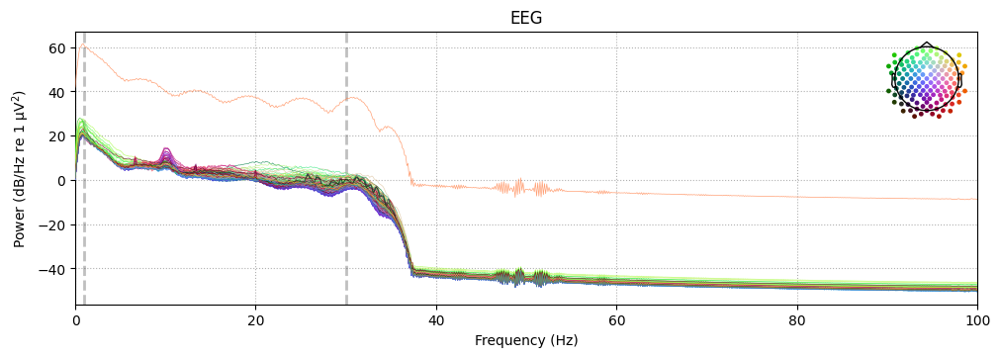

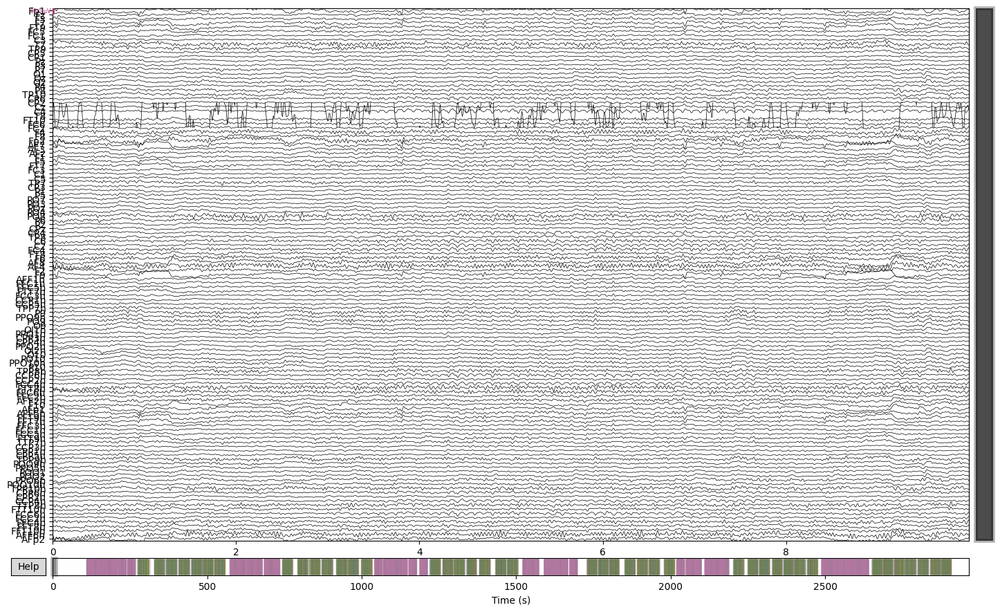

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:71: RuntimeWarning: Using n_components=60 (resulting in n_components_=60) may lead to an unstable mixing matrix estimation because the ratio between the largest (1.3e+02) and smallest (0.00011) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 56
  ica.fit(eeg_preprocess)


Fitting ICA took 20.2s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:05:22,891 - INFO - Processing subject: sub-02


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-02/eeg/sub-02_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3078059  =      0.000 ...  3078.059 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


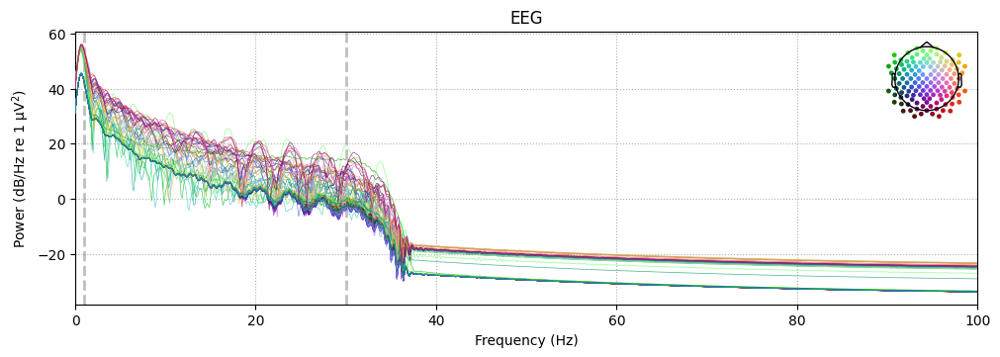

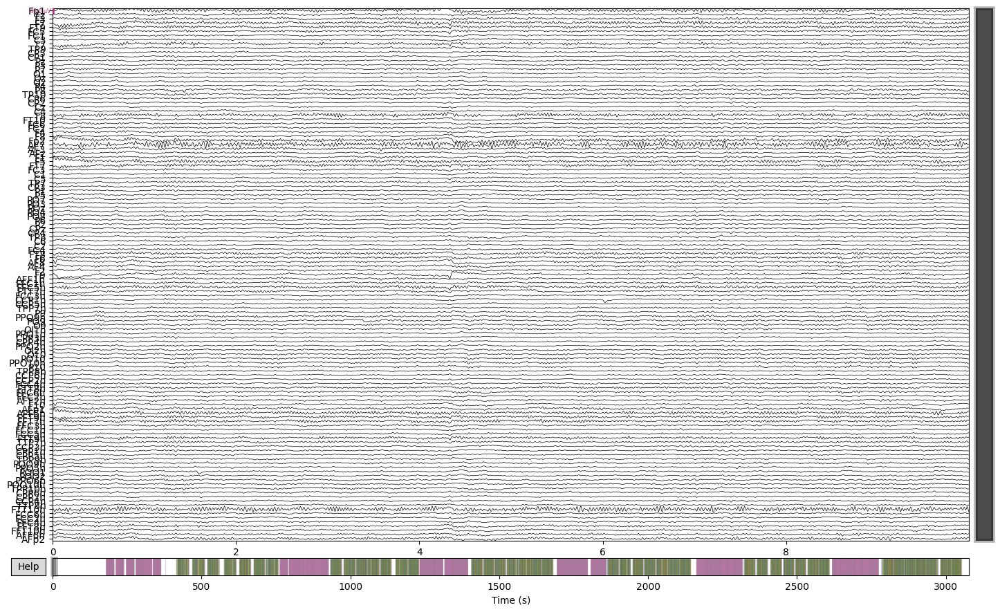

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:71: RuntimeWarning: Using n_components=60 (resulting in n_components_=60) may lead to an unstable mixing matrix estimation because the ratio between the largest (69) and smallest (1.2e-06) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 37
  ica.fit(eeg_preprocess)


Fitting ICA took 34.0s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:07:01,773 - INFO - Processing subject: sub-03


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-03/eeg/sub-03_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3235819  =      0.000 ...  3235.819 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


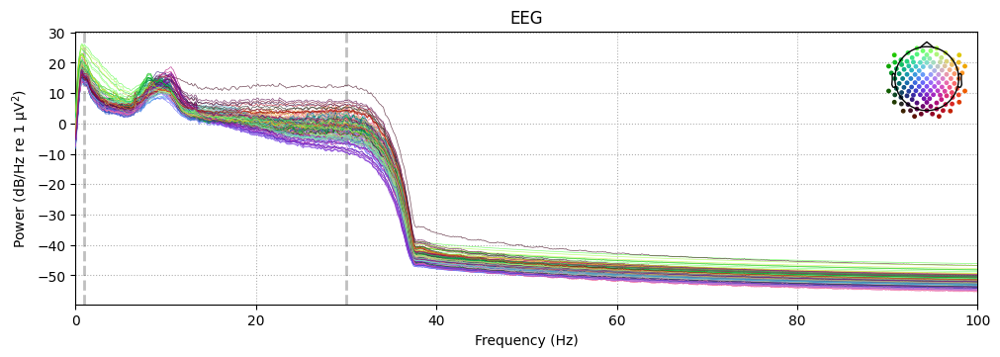

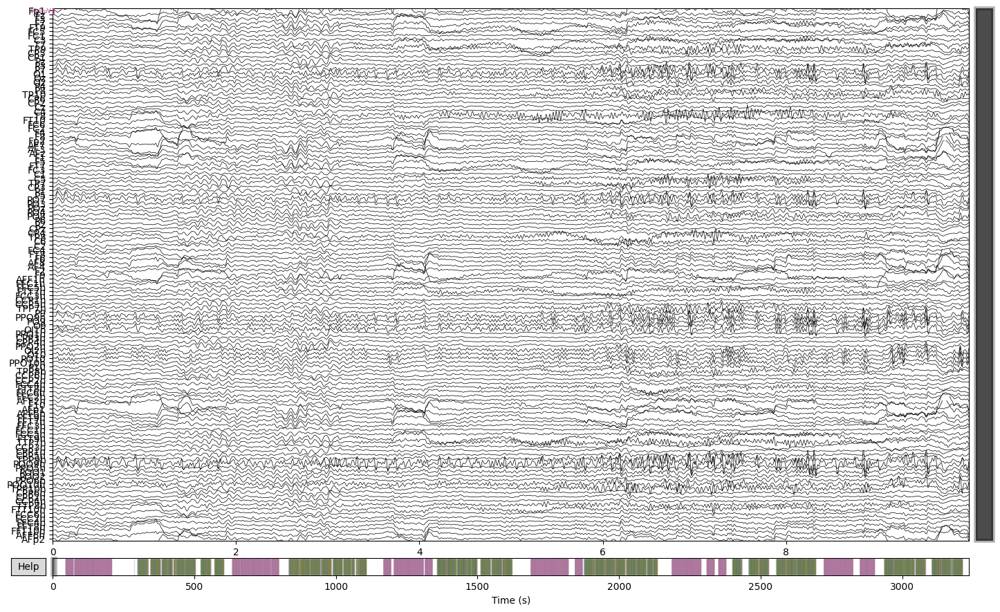

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 25.4s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:08:35,253 - INFO - Processing subject: sub-04


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-04/eeg/sub-04_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3351399  =      0.000 ...  3351.399 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


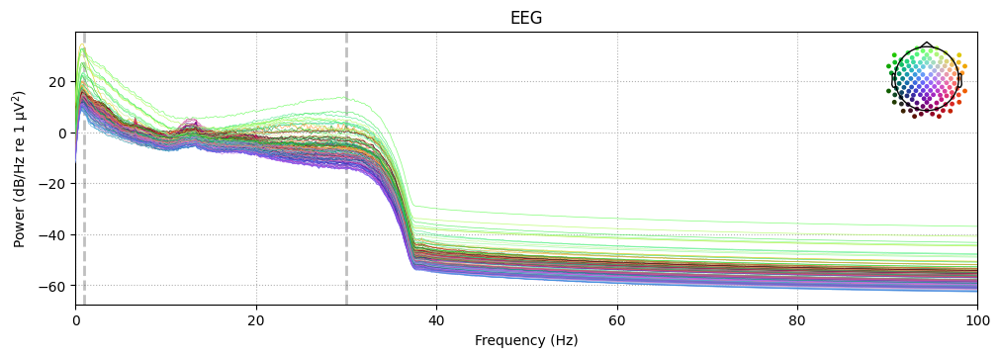

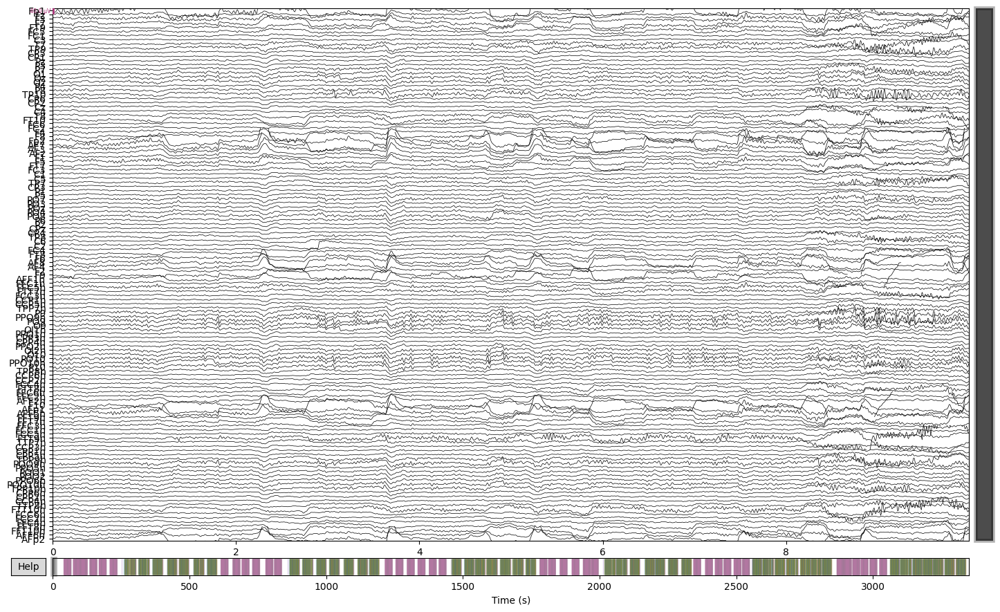

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 28.6s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:10:14,267 - INFO - Processing subject: sub-05


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-05/eeg/sub-05_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2897119  =      0.000 ...  2897.119 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


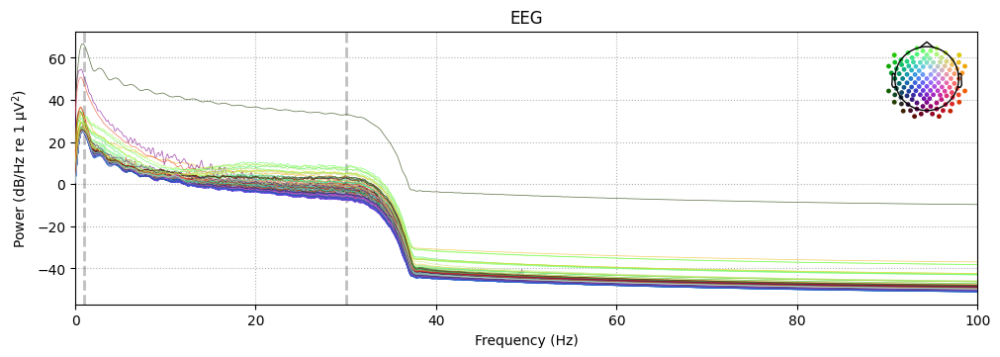

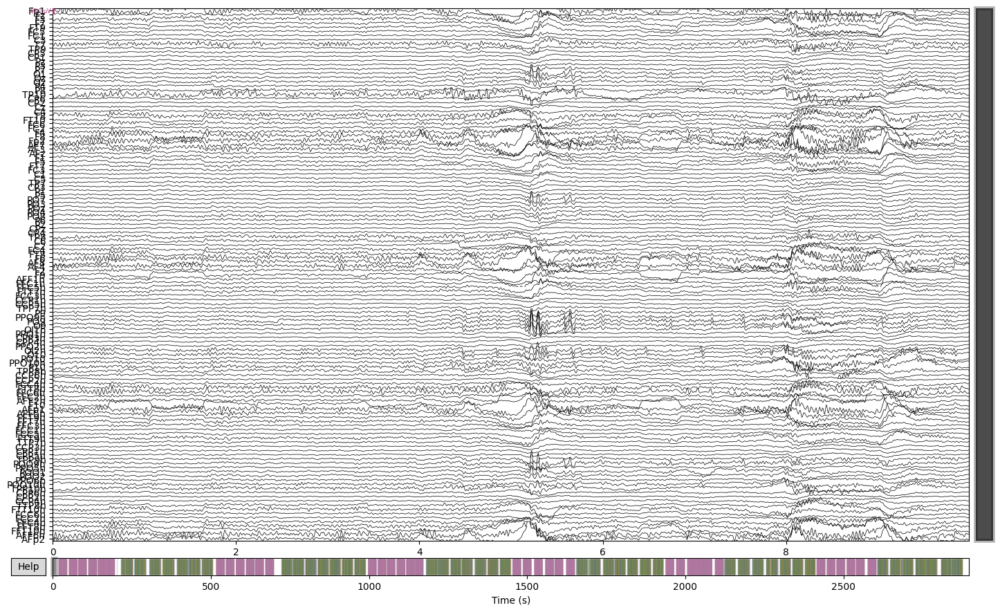

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 24.1s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:11:43,266 - INFO - Processing subject: sub-06


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-06/eeg/sub-06_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3061559  =      0.000 ...  3061.559 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


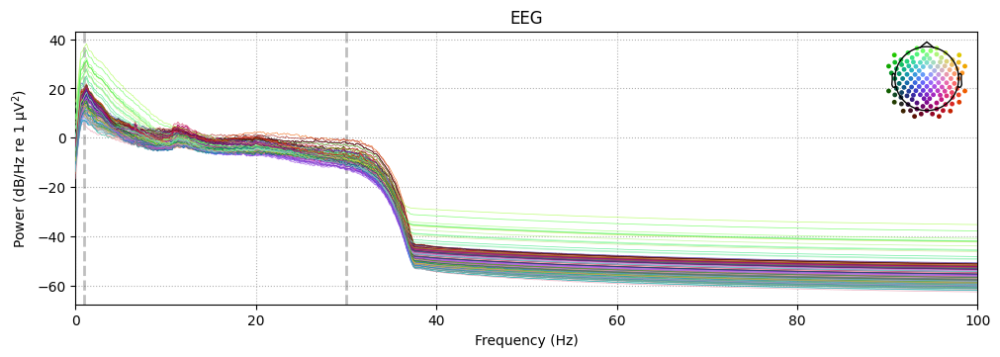

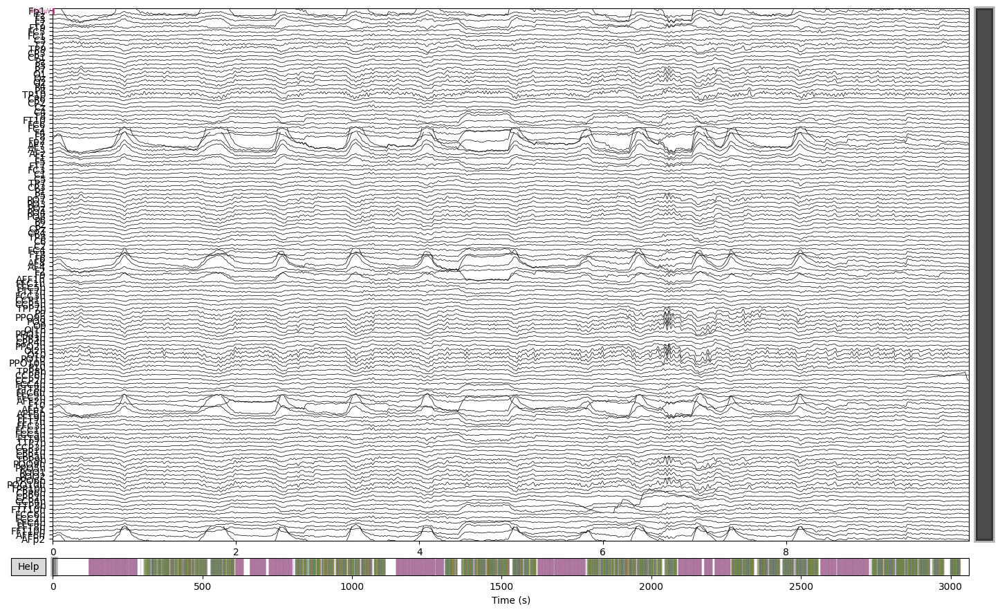

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 21.0s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:13:10,369 - INFO - Processing subject: sub-07


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-07/eeg/sub-07_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2926739  =      0.000 ...  2926.739 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


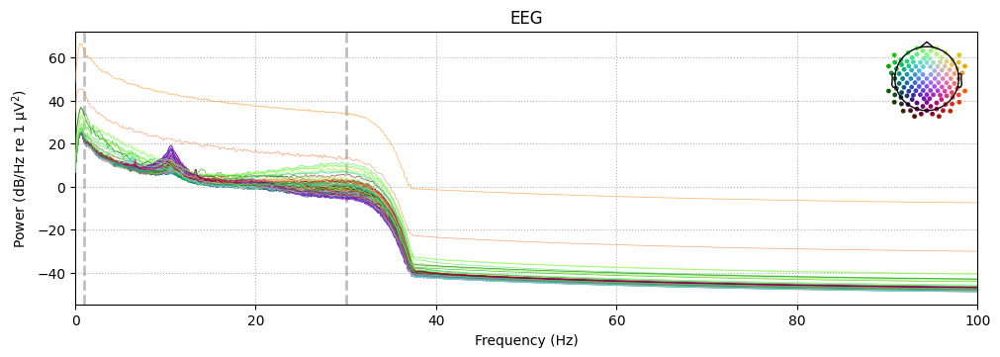

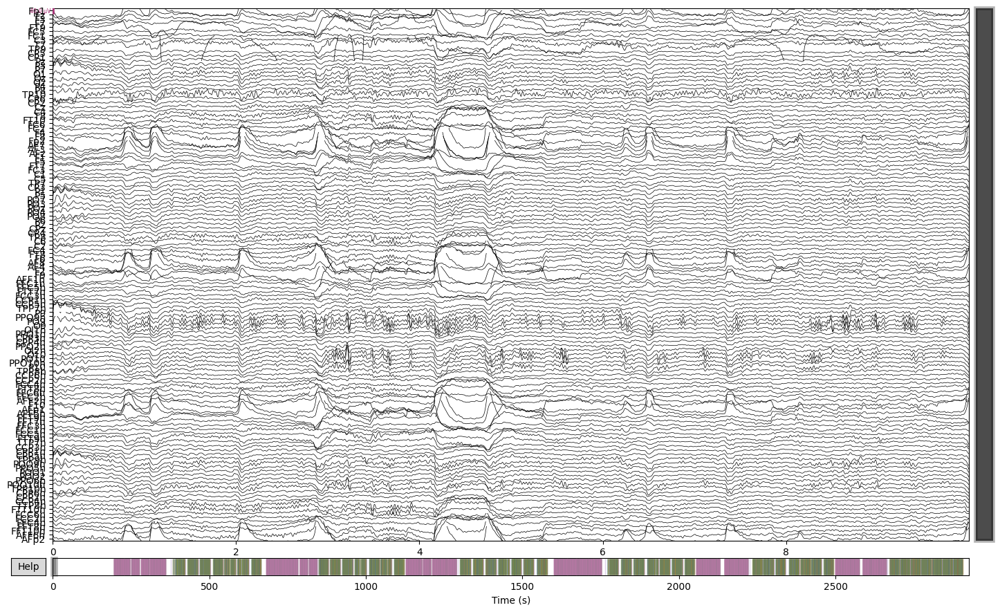

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 29.6s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:14:45,012 - INFO - Processing subject: sub-08


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-08/eeg/sub-08_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2641639  =      0.000 ...  2641.639 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


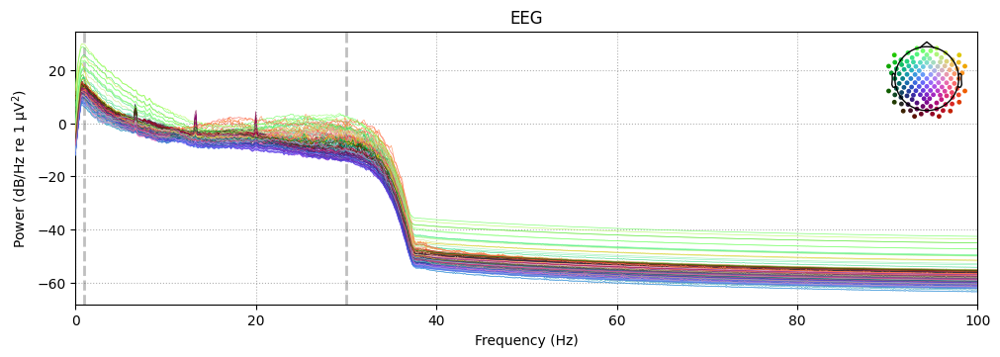

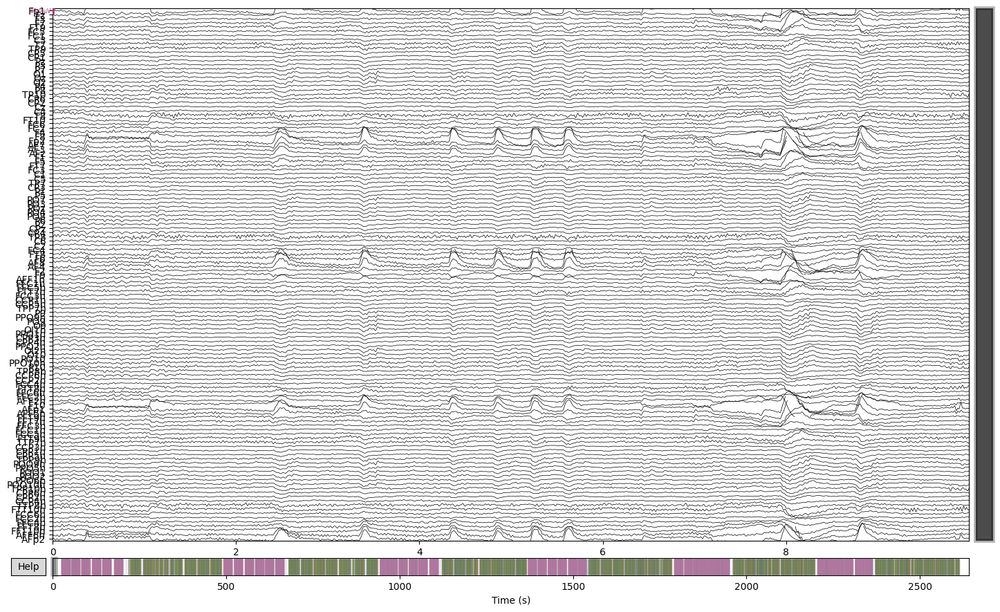

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 20.6s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:16:08,988 - INFO - Processing subject: sub-09


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-09/eeg/sub-09_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2771459  =      0.000 ...  2771.459 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


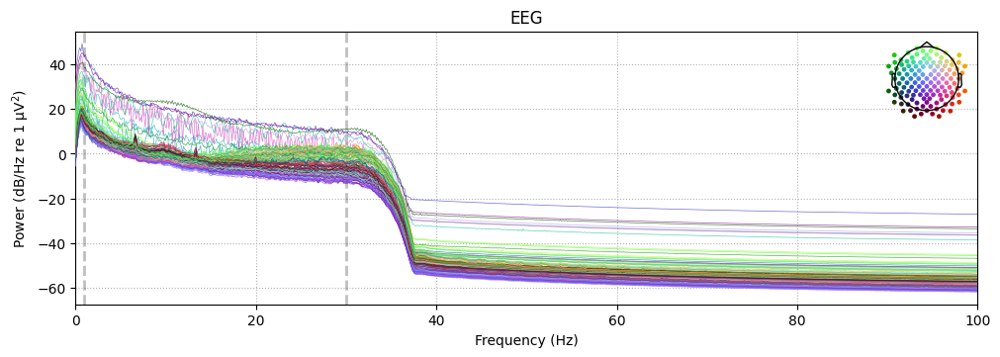

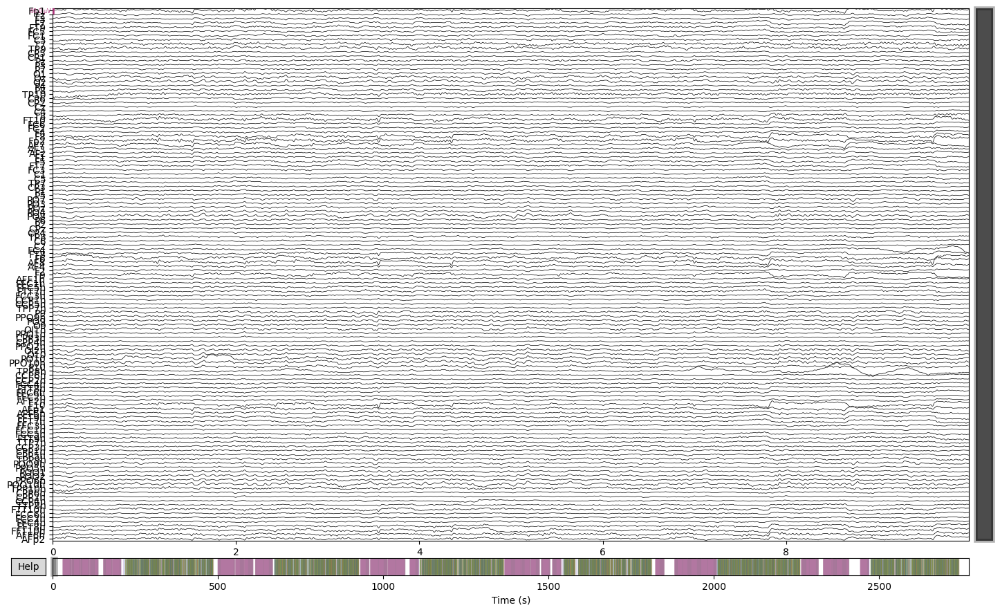

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 25.9s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:17:39,440 - INFO - Processing subject: sub-10


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-10/eeg/sub-10_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2762939  =      0.000 ...  2762.939 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


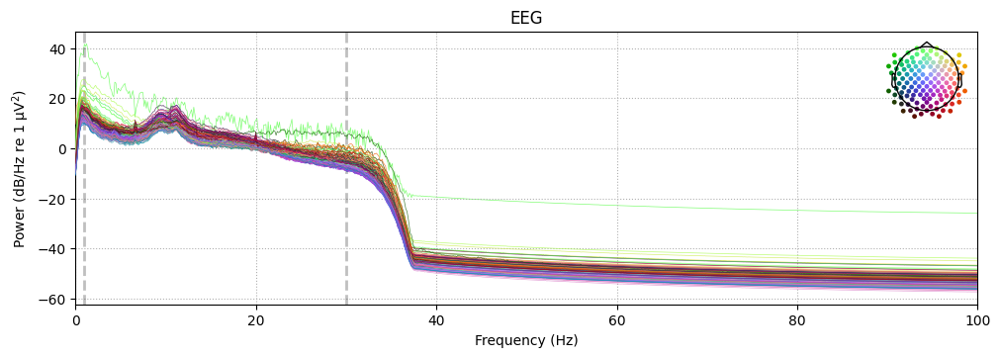

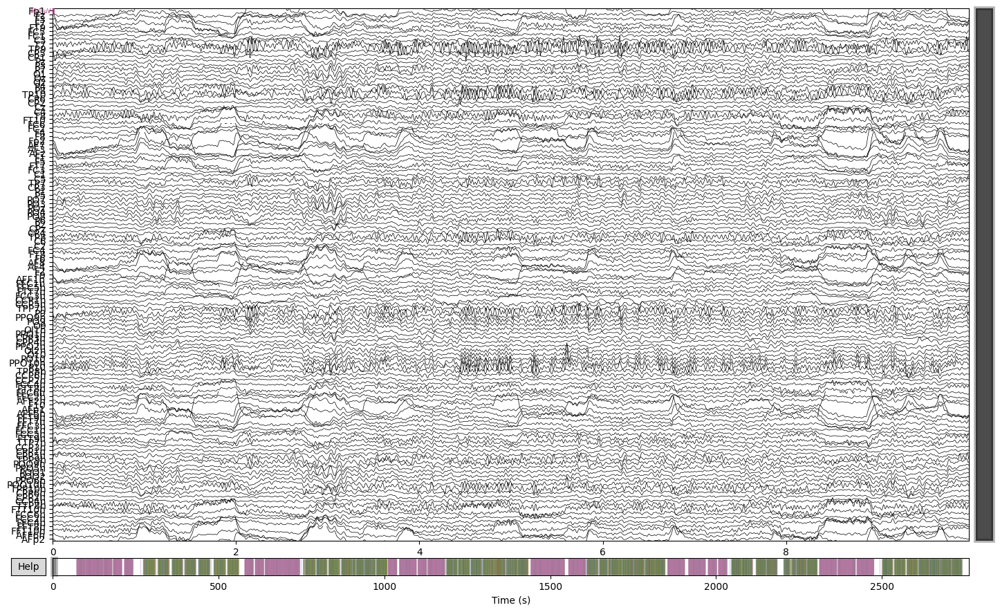

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 20.2s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:19:05,238 - INFO - Processing subject: sub-11


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-11/eeg/sub-11_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2733259  =      0.000 ...  2733.259 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


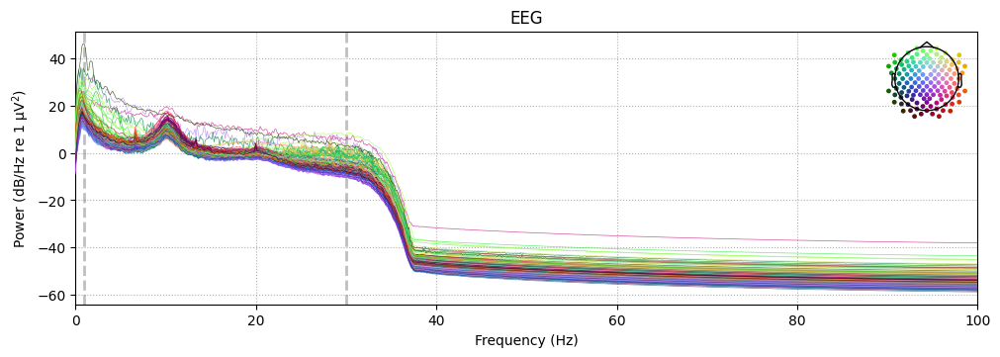

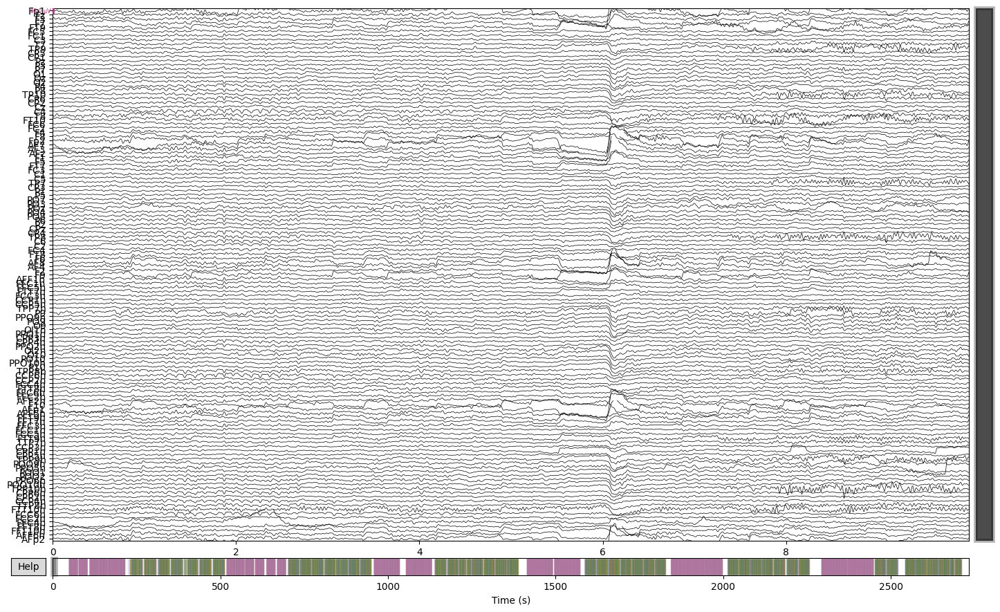

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 21.1s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:20:30,450 - INFO - Processing subject: sub-12


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-12/eeg/sub-12_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2696559  =      0.000 ...  2696.559 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


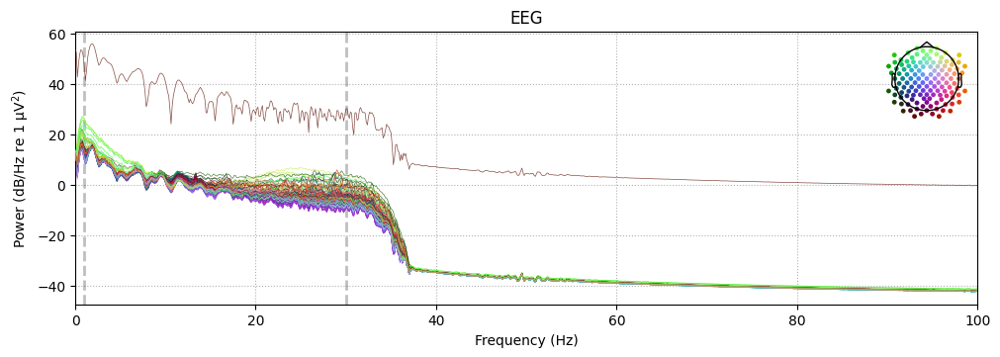

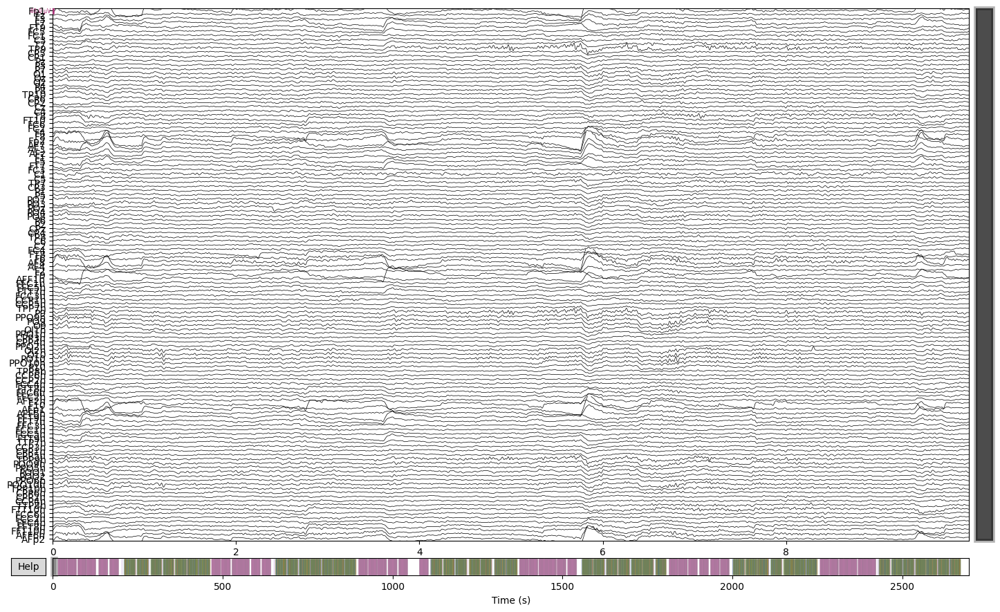

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:71: RuntimeWarning: Using n_components=60 (resulting in n_components_=60) may lead to an unstable mixing matrix estimation because the ratio between the largest (1.3e+02) and smallest (4.8e-05) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 30
  ica.fit(eeg_preprocess)


Fitting ICA took 19.8s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:21:55,210 - INFO - Processing subject: sub-13


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-13/eeg/sub-13_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3196039  =      0.000 ...  3196.039 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


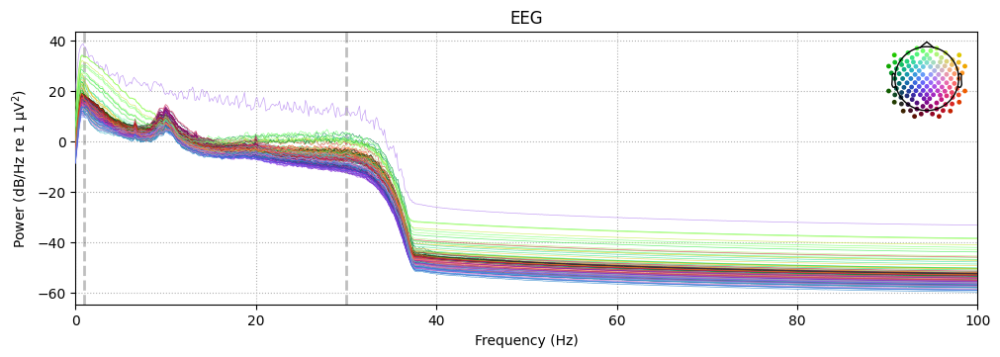

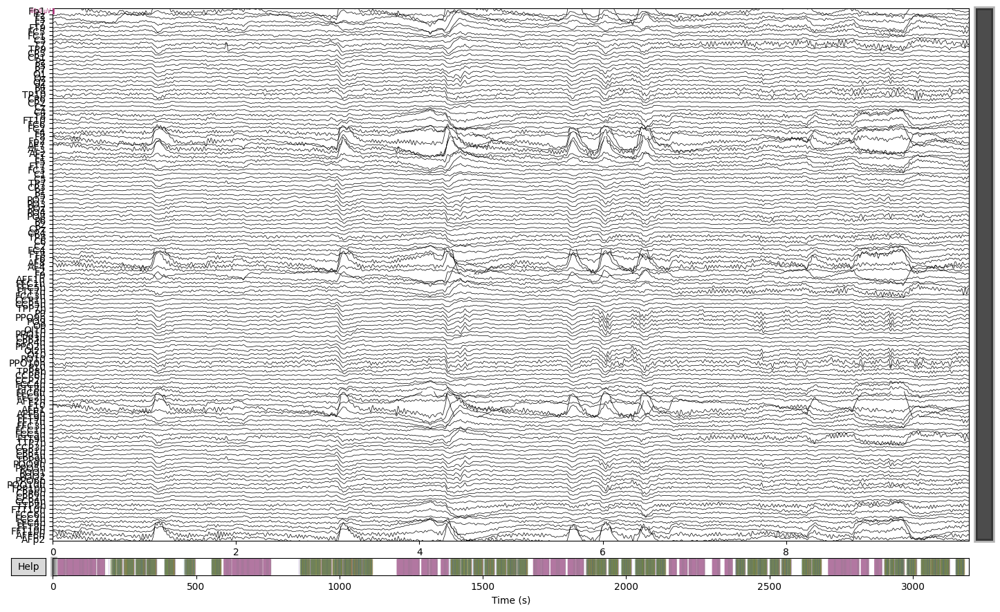

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 16.3s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:23:18,466 - INFO - Processing subject: sub-14


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-14/eeg/sub-14_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2687159  =      0.000 ...  2687.159 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


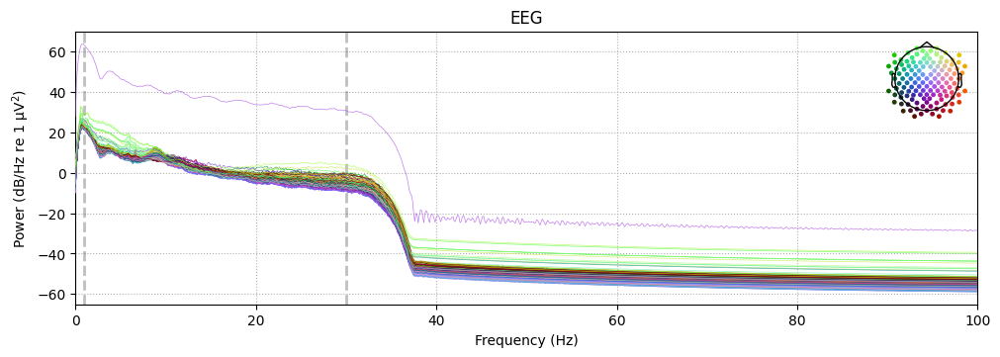

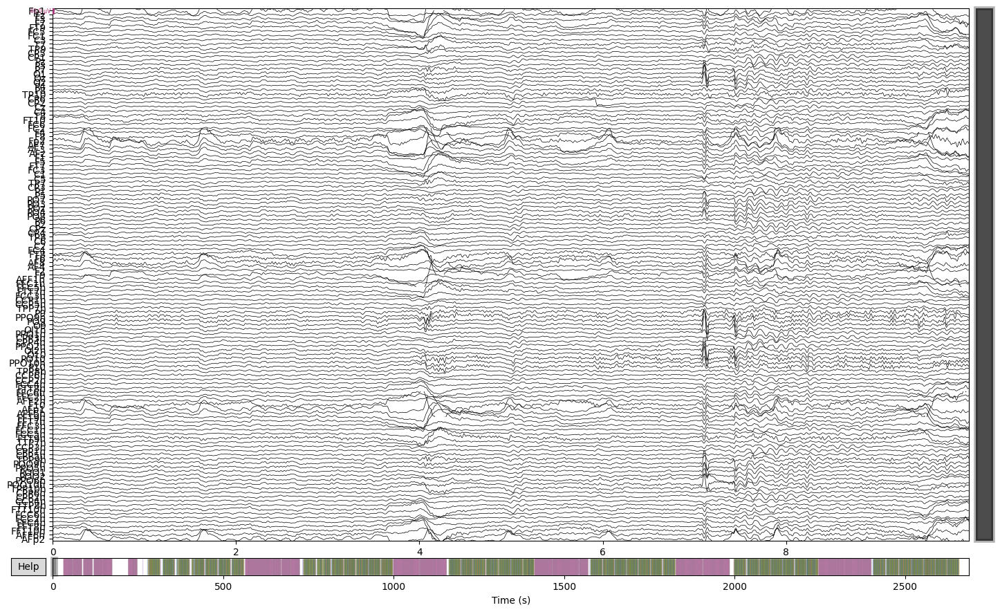

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:71: RuntimeWarning: Using n_components=60 (resulting in n_components_=60) may lead to an unstable mixing matrix estimation because the ratio between the largest (1.3e+02) and smallest (5.8e-05) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 40
  ica.fit(eeg_preprocess)


Fitting ICA took 24.8s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:24:46,404 - INFO - Processing subject: sub-15


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-15/eeg/sub-15_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2950919  =      0.000 ...  2950.919 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


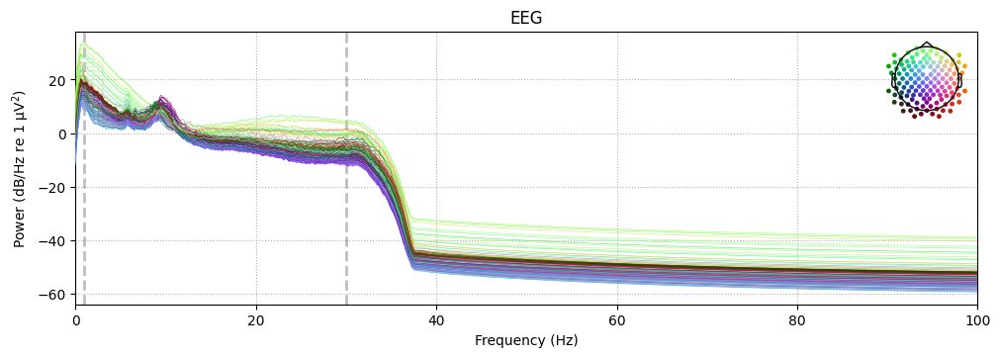

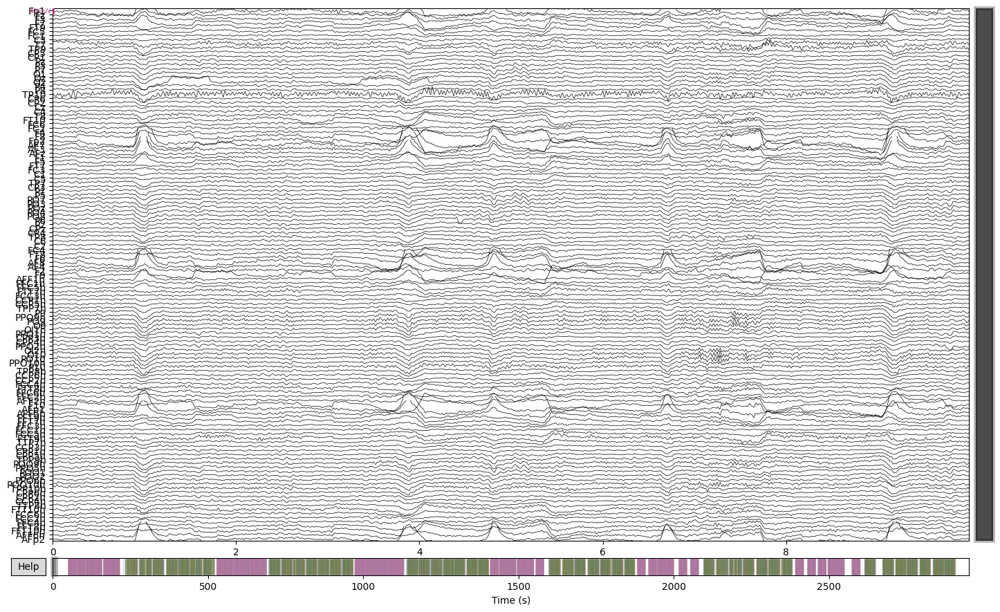

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 19.9s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:26:11,106 - INFO - Processing subject: sub-16


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-16/eeg/sub-16_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3020039  =      0.000 ...  3020.039 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


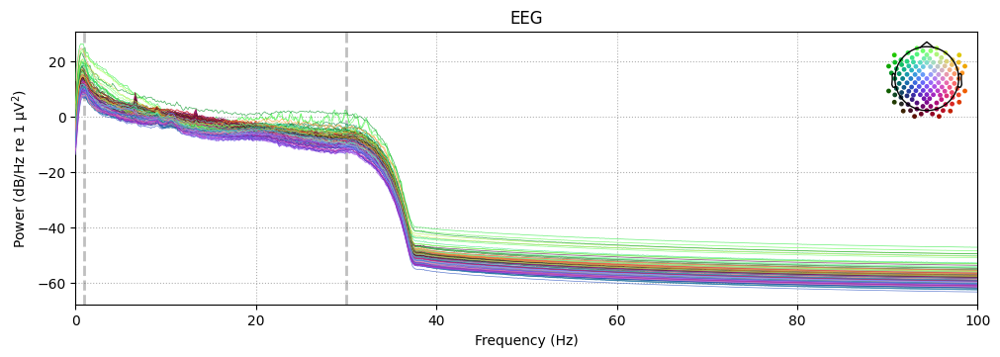

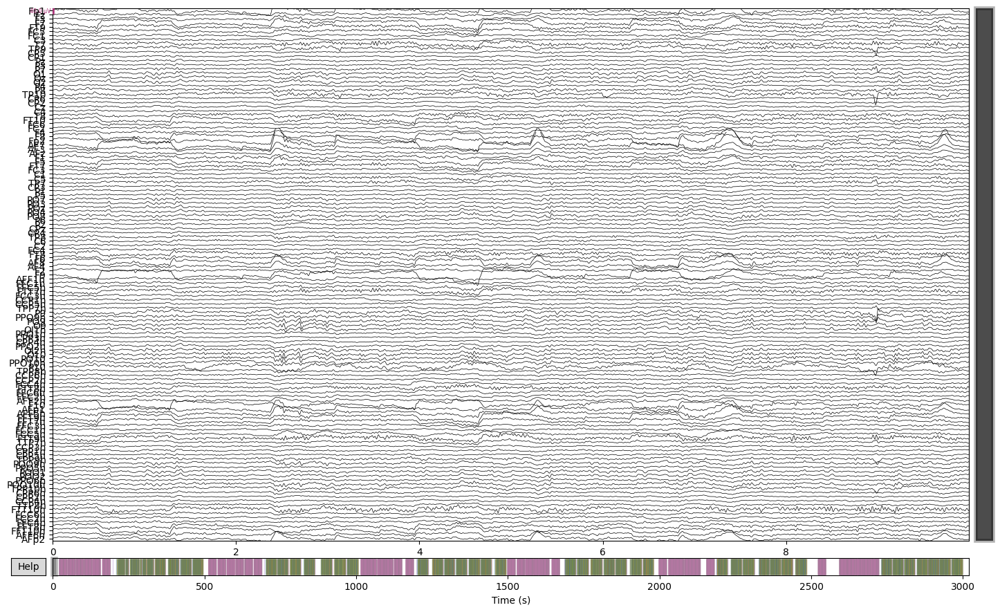

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 19.1s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:27:35,767 - INFO - Processing subject: sub-17


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-17/eeg/sub-17_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2790579  =      0.000 ...  2790.579 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


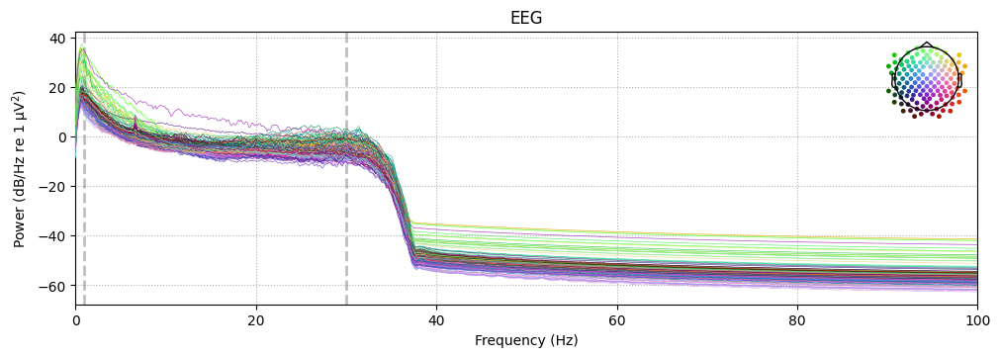

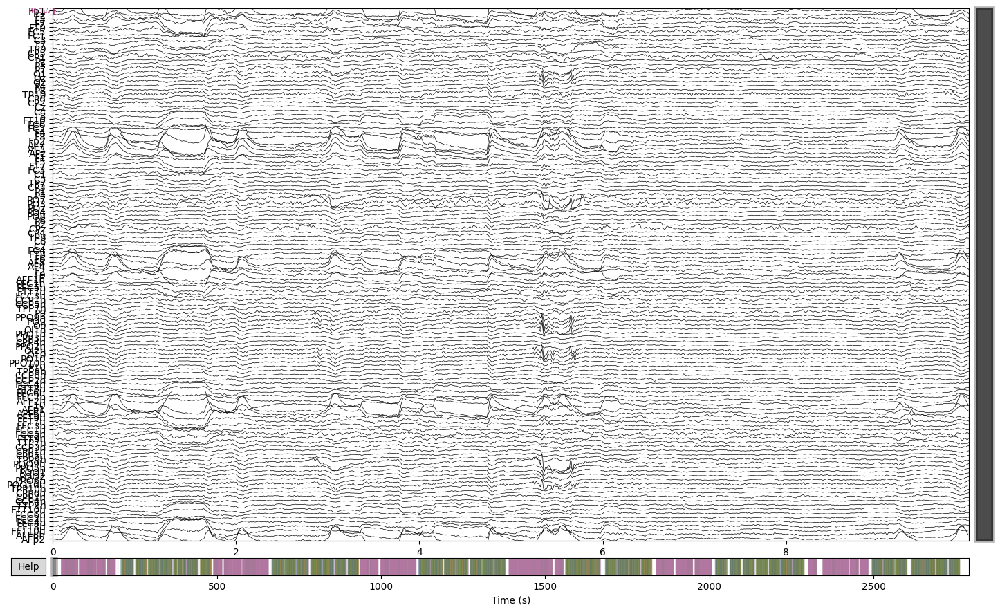

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 23.0s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:29:03,108 - INFO - Processing subject: sub-18


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-18/eeg/sub-18_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2633959  =      0.000 ...  2633.959 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


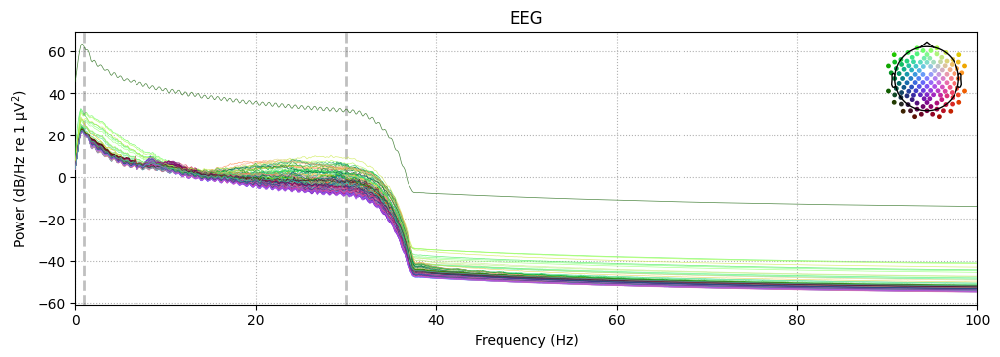

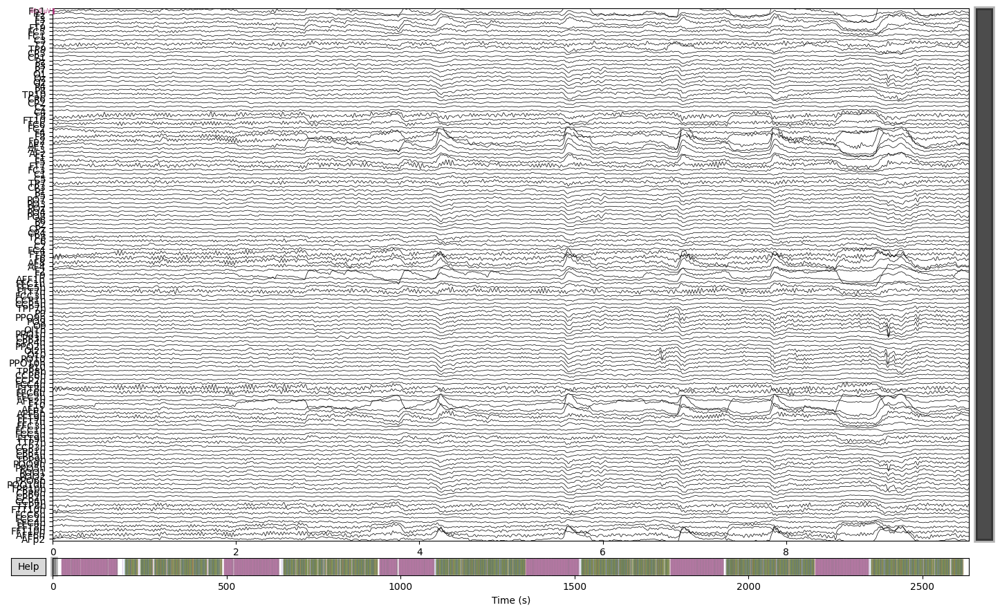

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 21.5s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:30:26,956 - INFO - Processing subject: sub-19


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-19/eeg/sub-19_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 2823679  =      0.000 ...  2823.679 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


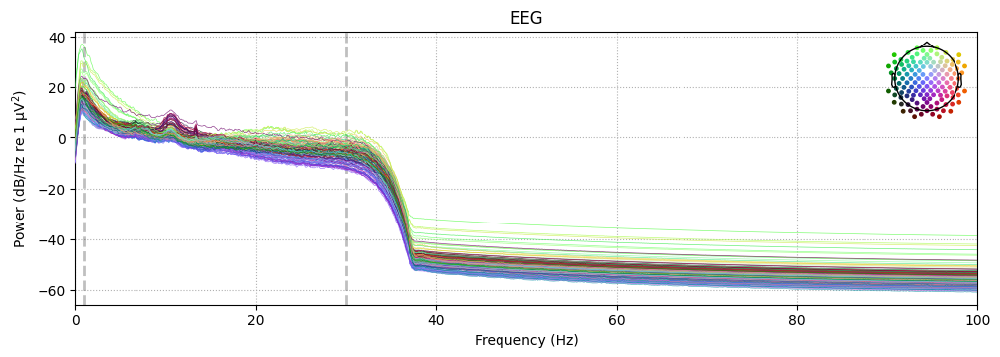

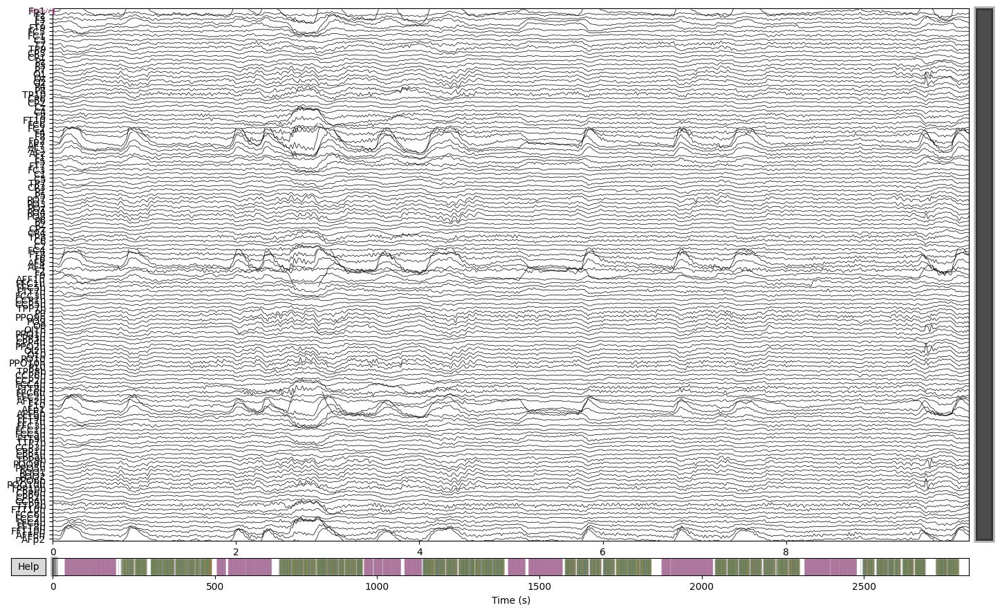

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 24.0s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(
2025-12-13 10:31:55,581 - INFO - Processing subject: sub-20


Extracting parameters from /volumes/hyijie_psy/CPP/high_Moerel_2024/sub-20/eeg/sub-20_task-food_eeg.vhdr...
Setting channel info structure...
Reading 0 ... 3057919  =      0.000 ...  3057.919 secs...
Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 6601 samples (6.601 s)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) meth

/opt/miniconda3/envs/env4eeg/lib/python3.13/site-packages/mne/viz/utils.py:160: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


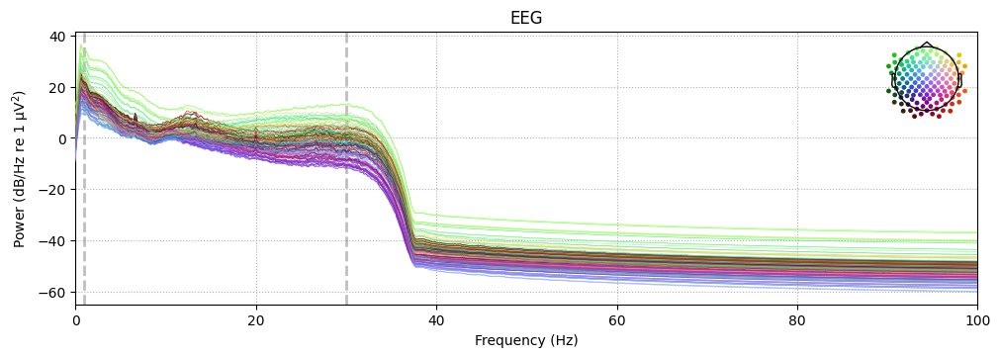

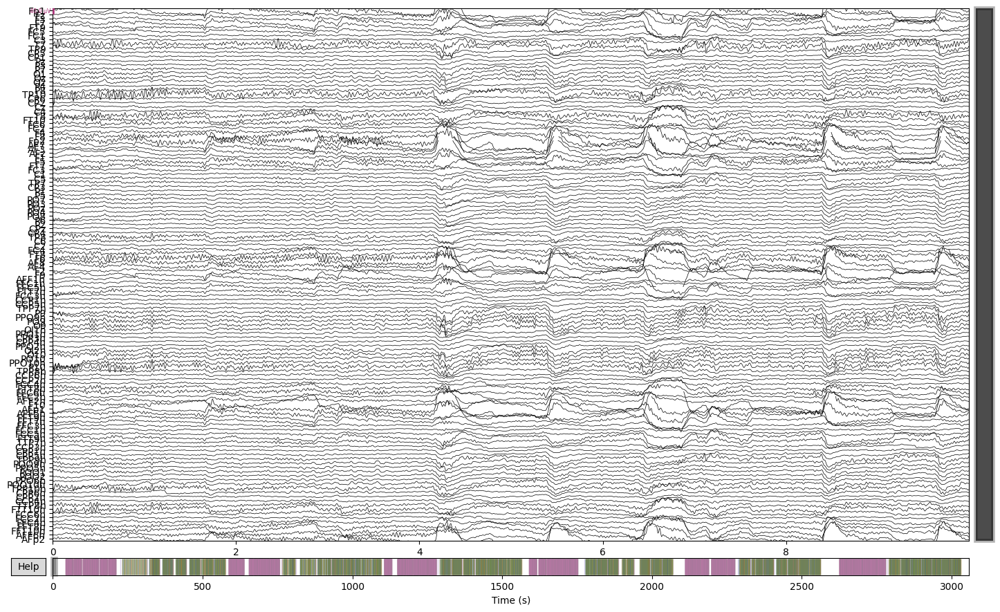

Fitting ICA to data using 127 channels (please be patient, this may take a while)
Selecting by number: 60 components
Fitting ICA took 22.6s.
Applying ICA to Raw instance
    Transforming to ICA space (60 components)
    Zeroing out 0 ICA components
    Projecting back using 127 PCA components


/var/folders/xc/16fqwx1n1gbfb77yd1bdg8mh0000gn/T/ipykernel_90848/4056684756.py:85: RuntimeWarning: Converting data files to BrainVision format
  write_raw_bids(


In [5]:
# =============================================================================
# EEG preprocess
# =============================================================================
# Load the index of excluded subjects
excluded_sub_set = set() 
excluded_file = os.path.join(PATH_RAW_DATA_BIDS, 'sub_excluded.csv')

if os.path.exists(excluded_file):
    excluded_sub_df = pd.read_csv(excluded_file, header=None)
    excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())
    logger.info(f"Loaded {len(excluded_sub_set)} excluded subjects from file.")
else:
    logger.info("No excluded subjects file found; proceeding with empty exclusion list.")
bad_chs_full = []

for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    logger.info(f"Processing subject: {sub_idx}")
    # === step 1: Load eeg and behavior data ===
    # Set path for loading 
    path_eeg = os.path.join(DS_ROOT, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL+BIDS_EEG_SUFFIX + '.vhdr')
    assert os.path.exists(path_eeg), f"EEG file not found: {path_eeg}"

    # Load eeg and behavior data
    eeg_bids = mne.io.read_raw_brainvision(path_eeg, preload=True)

    # === Step 2: Main content of preprocessing ===
    # == 2.1 Notch filtering ==
    eeg_preprocess = eeg_bids.copy().notch_filter(50)

    # == 2.2 Resample ==
    eeg_preprocess.resample(256, npad="auto")
    
    # == 2.3 Filtering ==
    eeg_preprocess.filter(1, 30, fir_design='firwin', picks=['eeg'])

    # == 2.4 re-reference ==
    eeg_preprocess.set_eeg_reference('average')  

    # == 2.5 Indentify bad channels by visual inspection==
    # Plot PSD to check first
    eeg_preprocess.compute_psd(fmax=100).plot(picks="data", exclude="bads", amplitude=False)
    # Plot EEG data
    eeg_preprocess.plot(n_channels = 127, scalings = 20e-6, block=True) #scalings = 20e-6,
    # Record bad channels
    bad_chans = eeg_preprocess.info['bads']
    if len(bad_chans) == 0:
        # No bad channels: add a raw, bad_channel is NaN
        bad_chs_full.append({
            "subj_idx": sub_idx,
            "bad_channel": pd.NA
        })
    else:
        # hava bad channels
        for bad_chan in bad_chans:
            bad_chs_full.append({
                "subj_idx": sub_idx,
                "bad_channel": bad_chan
            })

    # == 2.6 Remove artifacts using ICA ==
    # ica remove artifact
    # eeg_chs = mne.pick_types(eeg_preprocess.info, eeg=True, exclude='bads') 
    # n_eeg_good = len(eeg_chs)
    ica = mne.preprocessing.ICA(n_components=60, random_state=42, method='fastica')
    ica.fit(eeg_preprocess) 
    #ica.exclude = []                                   
    #eog_indices, eog_scores = ica.find_bads_eog(eeg_preprocess)                                                                     
    #ica.exclude = eog_indices
    eeg_clean = ica.apply(eeg_preprocess) 

    # === Step 3: Save preprocessed data into BIDS ===
    bids_path = BIDSPath(
        subject=sub_idx.replace('sub-', ''),
        task='food',
        datatype='eeg',
        root=PATH_PREPROCESS_DARA_BIDS
    )

    write_raw_bids(
        raw=eeg_clean,
        bids_path=bids_path,
        format='BrainVision',
        allow_preload=True,
        overwrite=True,
        verbose=False
    )

# Save full bad channels cross subjects
bad_chs_full = pd.DataFrame(bad_chs_full)
bad_chs_full.to_csv(
        os.path.join(PATH_PREPROCESS_DARA_BIDS, 'all_bad_channels.csv'),
        index=False
    )

In [6]:
# =============================================================================
# Save cleaned behavior data into BIDS
# =============================================================================
# Load the index of excluded subjects
data_invalid_trials_full = pd.read_csv(os.path.join(PATH_RAW_DATA_BIDS, 'all_invalid_trials.csv'), header=0)

if os.path.exists(excluded_file):
    excluded_sub_df = pd.read_csv(excluded_file, header=None)
    excluded_sub_set = set(excluded_sub_df.iloc[:, 0].tolist())
    logger.info(f"Loaded {len(excluded_sub_set)} excluded subjects from file.")
else:
    logger.info("No excluded subjects file found; proceeding with empty exclusion list.")
bad_chs_full = []

for sub_idx in SUBJECT_IDS:
    if sub_idx in excluded_sub_set:
        continue

    # Extract invalid trials.
    data_invalid_trial = data_invalid_trials_full[data_invalid_trials_full['subj_idx'] == sub_idx]
    invalid_from_behavior = set(data_invalid_trial['invalid_trial_index'])
    index_invalid_from_behavior = sorted(invalid_from_behavior)

    logger.info(f"Processing subject: {sub_idx}")

    # === Step 1: Load behavioral and eeg data ===
    # Set path for loading 
    path_beh = os.path.join(DS_ROOT, 
                            sub_idx, 
                            'eeg',
                            sub_idx+BIDS_TASK_LABEL+'_events' + '.tsv')
    assert os.path.exists(path_beh), f"Behavior file not found: {path_beh}"

    # Load behavior data
    data_behavior_full = pd.read_csv(path_beh, sep='\t' , header=0)
    data_behavior = data_behavior_full[data_behavior_full['is_faststream'] == 0].reset_index(drop=True)

    # === Step 2: Select sepcific columns (aimed triggers) for behavior (eeg) data ===
    # Select specific columns: [-1, 11, 15, 14] → [subj_idx, condition, rt, response]
    data_behavior['subj_idx'] = sub_idx           # Add a column to get subject idx
    behavior_selected_cols = data_behavior.iloc[:, [-1, 11, 15, 14]].copy()
    behavior_selected_cols.columns = ['subj_idx', 'condition', 'rt', 'response']
    
    # === Step 3: Filter and save cleaned behavioral data ===
    data_behavior_clean= behavior_selected_cols.drop(index=index_invalid_from_behavior).reset_index(drop=True)

    # Save cleaned behavioral data into BIDS
    bids_path_beh = os.path.join(PATH_PREPROCESS_DARA_BIDS, sub_idx, 'beh')
    os.makedirs(bids_path_beh, exist_ok=True)
    beh_save_path = os.path.join(bids_path_beh, sub_idx+'_task-food_beh.tsv')
    data_behavior_clean.to_csv(beh_save_path, sep='\t', index=False, na_rep='n/a')

    logger.info(f"Subject {sub_idx}: BIDS conversion completed.")  



2025-12-13 10:33:24,149 - INFO - No excluded subjects file found; proceeding with empty exclusion list.
2025-12-13 10:33:24,160 - INFO - Processing subject: sub-01
2025-12-13 10:33:24,182 - INFO - Subject sub-01: BIDS conversion completed.
2025-12-13 10:33:24,183 - INFO - Processing subject: sub-02
2025-12-13 10:33:24,194 - INFO - Subject sub-02: BIDS conversion completed.
2025-12-13 10:33:24,195 - INFO - Processing subject: sub-03
2025-12-13 10:33:24,205 - INFO - Subject sub-03: BIDS conversion completed.
2025-12-13 10:33:24,205 - INFO - Processing subject: sub-04
2025-12-13 10:33:24,214 - INFO - Subject sub-04: BIDS conversion completed.
2025-12-13 10:33:24,214 - INFO - Processing subject: sub-05
2025-12-13 10:33:24,224 - INFO - Subject sub-05: BIDS conversion completed.
2025-12-13 10:33:24,224 - INFO - Processing subject: sub-06
2025-12-13 10:33:24,234 - INFO - Subject sub-06: BIDS conversion completed.
2025-12-13 10:33:24,234 - INFO - Processing subject: sub-07
2025-12-13 10:33:24,